In [1]:
import tifffile
import taufactor
import numpy as np
import matplotlib.pyplot as plt
import os

In [2]:
# Load files from the data folder, which can be downloaded from the link in the README
root = 'trained_generators/Scott/Scott_is_27/data'
files = os.listdir(root)
# Only want to look at the tif files that aren't the tau factor property images
files_tif = [root + f for f in files if f.endswith('].tif')]
dataset = [tifffile.imread(f) for f in files_tif]
labels = [f.split(']')[0].split('[')[-1] for f in files if f.endswith('].tif')]


FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\sk3619\\cGAN-Micro-Optimisation\\trained_generators\\Scott\\Scott_is_27\\dataScott_is_27[0, 0, 0.5].tif'

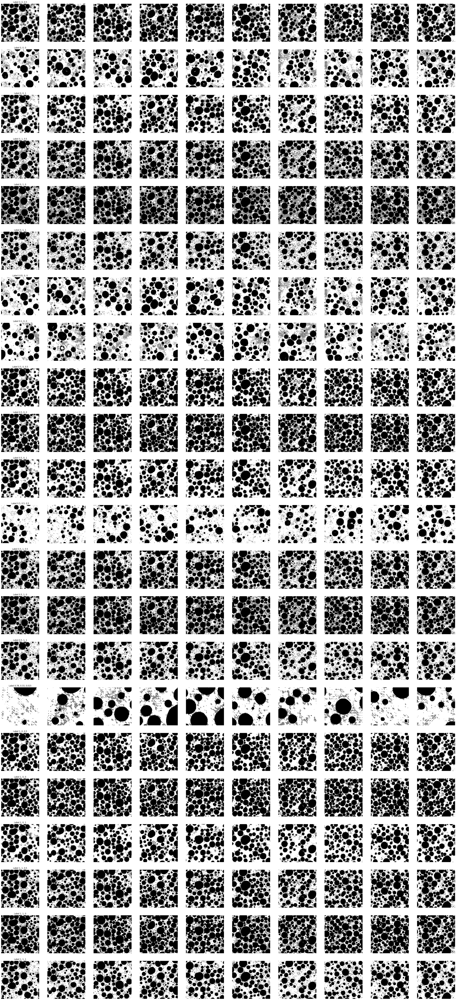

In [ ]:
# Show images. Note labels correspond to AM vf, CBD vf and binder adhesivity. See paper for more details.
fig, axs = plt.subplots(len(dataset), 10, figsize=(50, len(dataset)*5))
for i, (image, label) in enumerate(zip(dataset, labels)):
    axs[i, 0].set_title(f"Label {label}")
    if len(image.shape) != 3:
            image = image[0]
    for j in range(10):
        axs[i, j].imshow(image[j*38], cmap='gray')
        axs[i,j].axis('off')
    

In [ ]:
# Calc the tortuosity of each image
for i, (image, label) in enumerate(zip(dataset, labels)):
    image[image!=0] = 1

    s = taufactor.Solver(image)
    s.solve()
    print(s.tau)

converged to: 1.3965647220611572                   after: 701 iterations in: 7.4572                    seconds at a rate of 0.0106 s/iter
tensor(1.3966, device='cuda:0')
converged to: 1.2409987449645996                   after: 901 iterations in: 9.4082                    seconds at a rate of 0.0104 s/iter
tensor(1.2410, device='cuda:0')
converged to: 1.3096137046813965                   after: 901 iterations in: 9.413                    seconds at a rate of 0.0104 s/iter
tensor(1.3096, device='cuda:0')
converged to: 1.4143706560134888                   after: 701 iterations in: 7.3351                    seconds at a rate of 0.0105 s/iter
tensor(1.4144, device='cuda:0')
converged to: 1.5200985670089722                   after: 1001 iterations in: 10.4712                    seconds at a rate of 0.0105 s/iter
tensor(1.5201, device='cuda:0')
converged to: 1.3039143085479736                   after: 901 iterations in: 9.4204                    seconds at a rate of 0.0105 s/iter
tensor(1.30